In [ ]:
!pip install kaggle

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d soumikrakshit/anime-faces

Dataset URL: https://www.kaggle.com/datasets/soumikrakshit/anime-faces
License(s): unknown
100% 440M/441M [00:21<00:00, 23.3MB/s]
100% 441M/441M [00:21<00:00, 21.2MB/s]


In [ ]:
from zipfile import ZipFile
dataset = '/content/anime-faces.zip'

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [ ]:
!pip install tensorflow

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

In [ ]:
BASE_DIR='/content/data'

In [ ]:
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
image_paths[:5]

['/content/data/17983.png',
 '/content/data/4579.png',
 '/content/data/7381.png',
 '/content/data/9898.png',
 '/content/data/3752.png']

In [ ]:
len(image_paths)

21552

In [ ]:
image_paths.remove('/content/data/data')

In [ ]:
len(image_paths)

21551

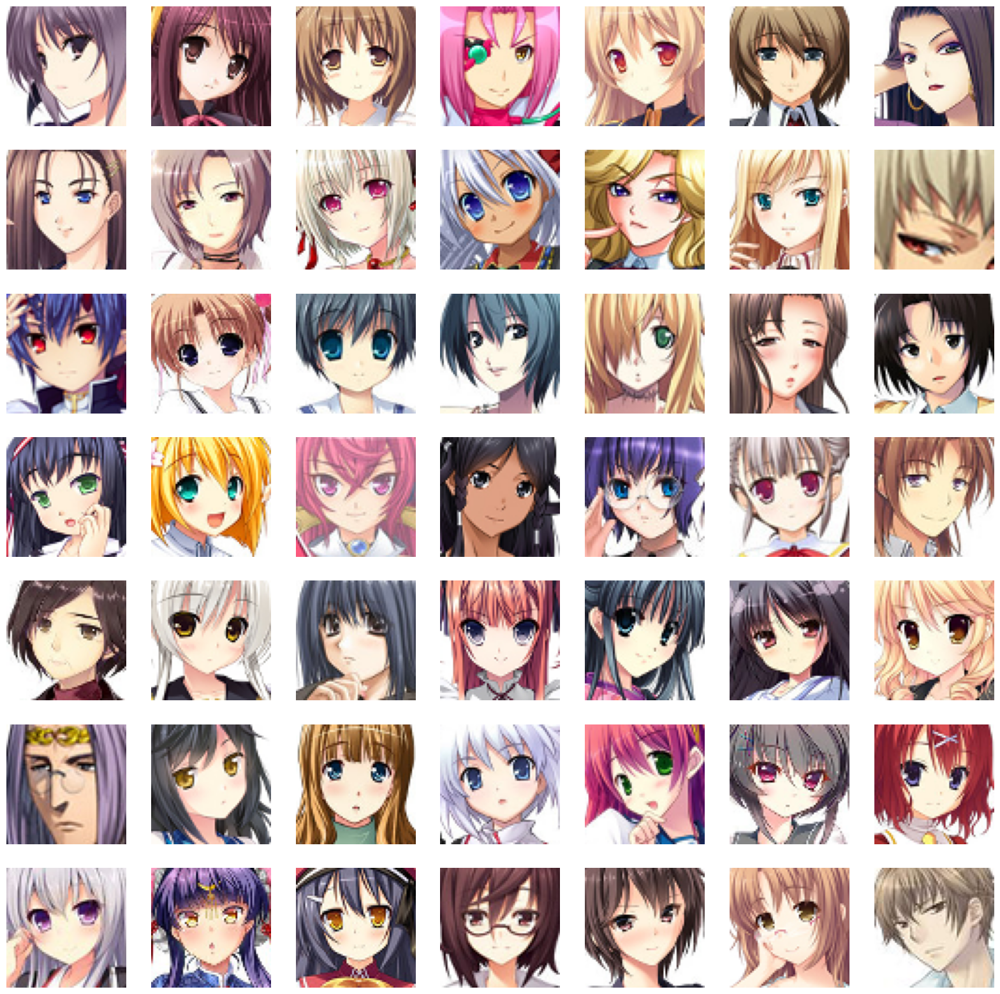

In [ ]:
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

In [ ]:
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [ ]:
train_images[0].shape

(64, 64, 3)

In [ ]:
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')


In [ ]:
train_images = (train_images - 127.5) / 127.5

In [ ]:
train_images[0]

array([[[ 0.9607843 ,  1.        ,  0.99215686],
        [ 1.        ,  1.        ,  1.        ],
        [ 0.3254902 ,  0.21568628,  0.31764707],
        ...,
        [ 0.09019608, -0.10588235,  0.06666667],
        [-0.08235294, -0.27058825, -0.09019608],
        [-0.03529412, -0.22352941, -0.03529412]],

       [[ 0.9843137 ,  1.        ,  1.        ],
        [ 1.        ,  0.94509804,  1.        ],
        [-0.11372549, -0.29411766, -0.13725491],
        ...,
        [ 0.05098039, -0.13725491,  0.05098039],
        [-0.06666667, -0.24705882, -0.06666667],
        [ 0.05098039, -0.12156863,  0.05882353]],

       [[ 1.        ,  1.        ,  1.        ],
        [ 0.654902  ,  0.6       ,  0.654902  ],
        [-0.18431373, -0.35686275, -0.20784314],
        ...,
        [ 0.01176471, -0.1764706 ,  0.01176471],
        [-0.04313726, -0.23137255, -0.04313726],
        [-0.01960784, -0.20784314, -0.01960784]],

       ...,

       [[ 1.        ,  1.        ,  1.        ],
        [ 1

In [19]:
LATENT_DIM = 100
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
CHANNELS = 3 # for gray scale, keep it as 1

In [20]:
model = Sequential(name='generator')


model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
model.add(layers.ReLU())


model.add(layers.Reshape((8, 8, 512)))


model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())


model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())


model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu (ReLU)                         │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_1 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_2 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_3 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

In [21]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2


model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))


model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

In [22]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):

        batch_size = tf.shape(real_images)[0]

        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))


        with tf.GradientTape() as tape:

            pred_real = self.discriminator(real_images, training=True)

            real_labels = tf.ones((batch_size, 1))

            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)


            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)

            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)


            d_loss = (d_loss_real + d_loss_fake) / 2


        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)

        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))



        labels = tf.ones((batch_size, 1))

        with tf.GradientTape() as tape:

            fake_images = self.generator(random_noise, training=True)

            pred_fake = self.discriminator(fake_images, training=True)

            g_loss = self.loss_fn(labels, pred_fake)


        gradients = tape.gradient(g_loss, self.generator.trainable_variables)

        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))


        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [23]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim

        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):

        g_img = self.model.generator(self.noise)

        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')

        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [24]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim

        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):

        g_img = self.model.generator(self.noise)

        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        plt.show()


        return logs if logs is not None else {}

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

        return logs if logs is not None else {}

In [25]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [26]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())


In [27]:
# Before running your code, check if 'zip' is a built-in function
import builtins
if not isinstance(builtins.zip, type(zip)):
    # If 'zip' is not the built-in function, restore it
    zip = builtins.zip
    print("Warning: 'zip' was overwritten. Restored to built-in function.")

Epoch 1/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step - d_loss: 1.1978 - g_loss: 1.9689

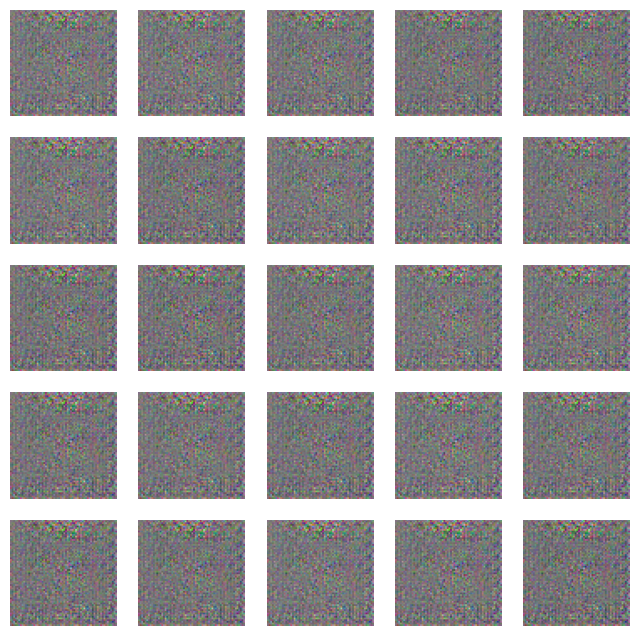

674/674 ━━━━━━━━━━━━━━━━━━━━ 76s 81ms/step - d_loss: 1.1968 - g_loss: 1.9702
Epoch 2/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.3626 - g_loss: 2.8071

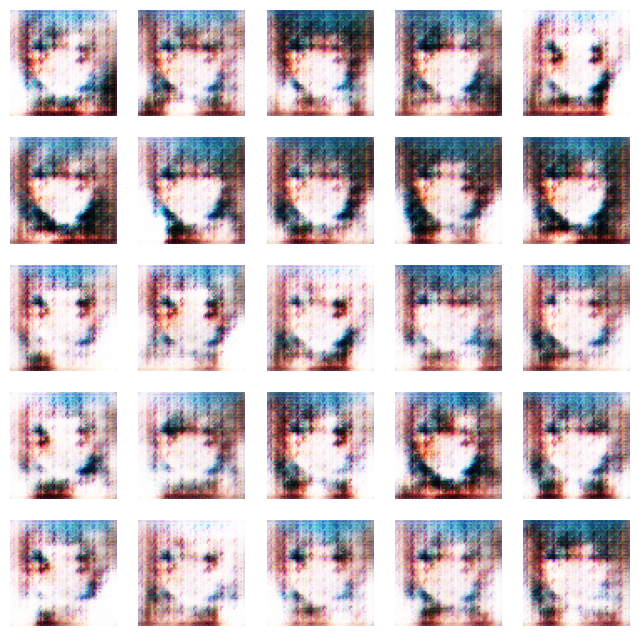

674/674 ━━━━━━━━━━━━━━━━━━━━ 55s 63ms/step - d_loss: 0.3629 - g_loss: 2.8054
Epoch 3/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5663 - g_loss: 1.9373

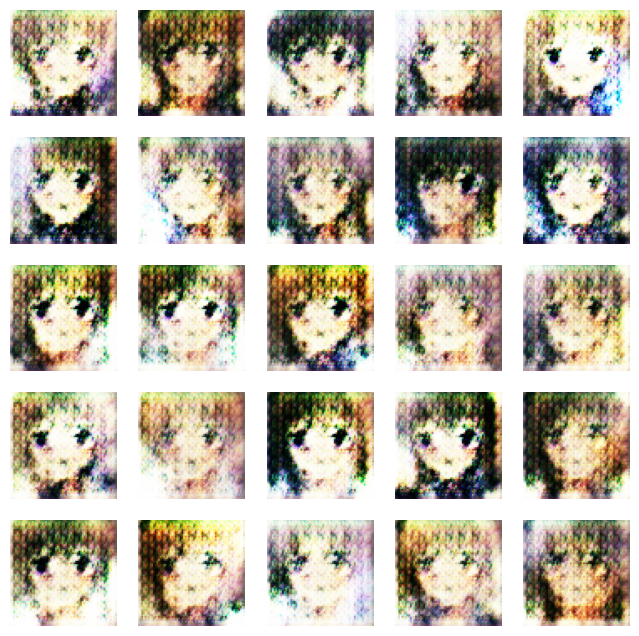

674/674 ━━━━━━━━━━━━━━━━━━━━ 81s 61ms/step - d_loss: 0.5664 - g_loss: 1.9371
Epoch 4/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6168 - g_loss: 1.7500

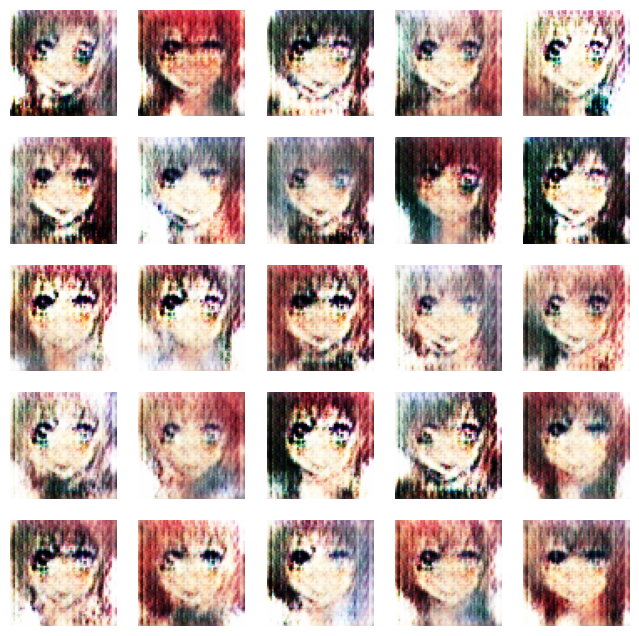

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 62ms/step - d_loss: 0.6167 - g_loss: 1.7501
Epoch 5/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.5817 - g_loss: 1.8356

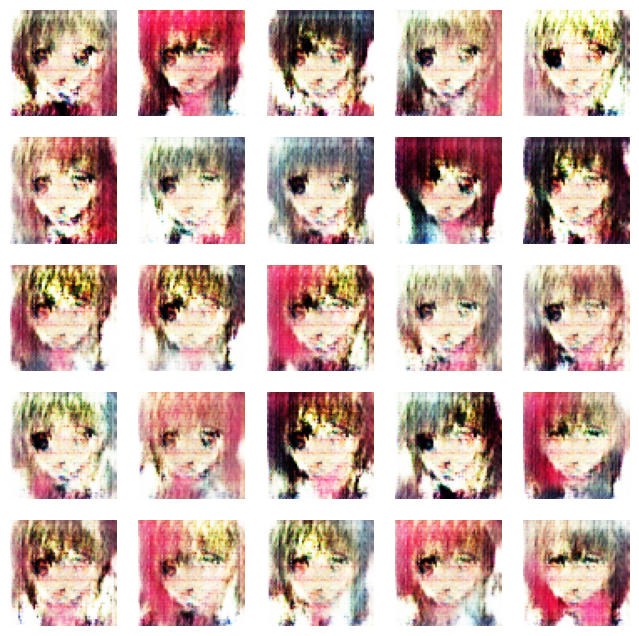

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 62ms/step - d_loss: 0.5817 - g_loss: 1.8357
Epoch 6/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.5756 - g_loss: 1.8481

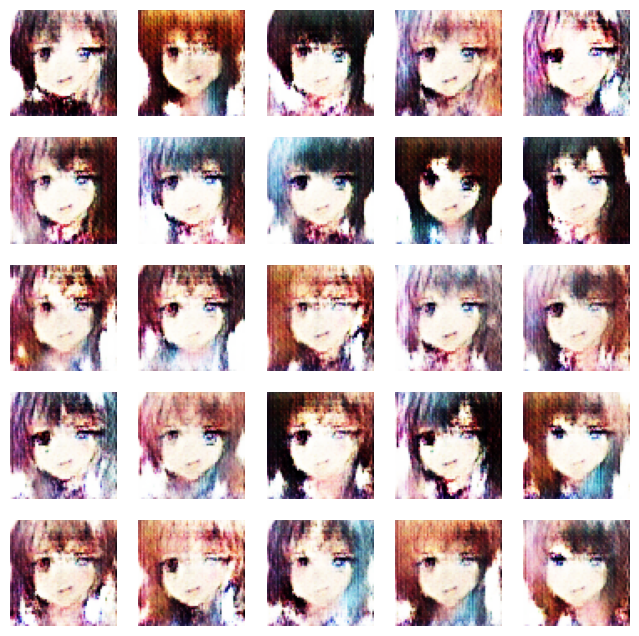

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.5756 - g_loss: 1.8481
Epoch 7/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5720 - g_loss: 1.7558

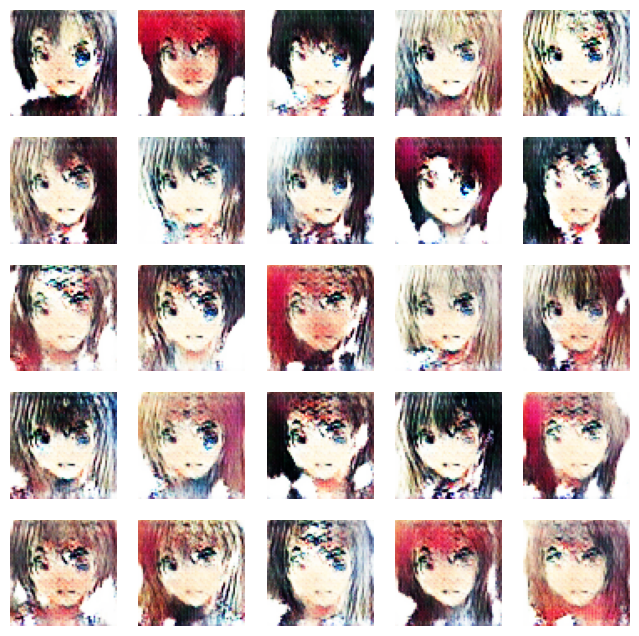

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.5720 - g_loss: 1.7560
Epoch 8/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.5585 - g_loss: 1.7090

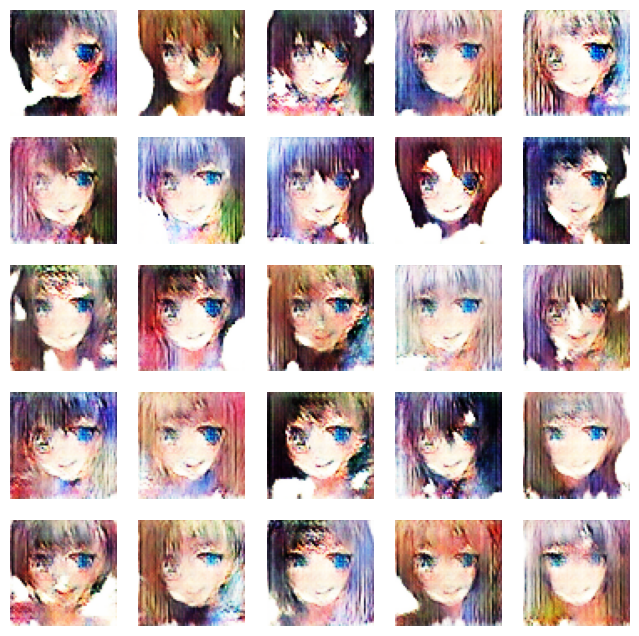

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 63ms/step - d_loss: 0.5585 - g_loss: 1.7090
Epoch 9/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5350 - g_loss: 1.7212

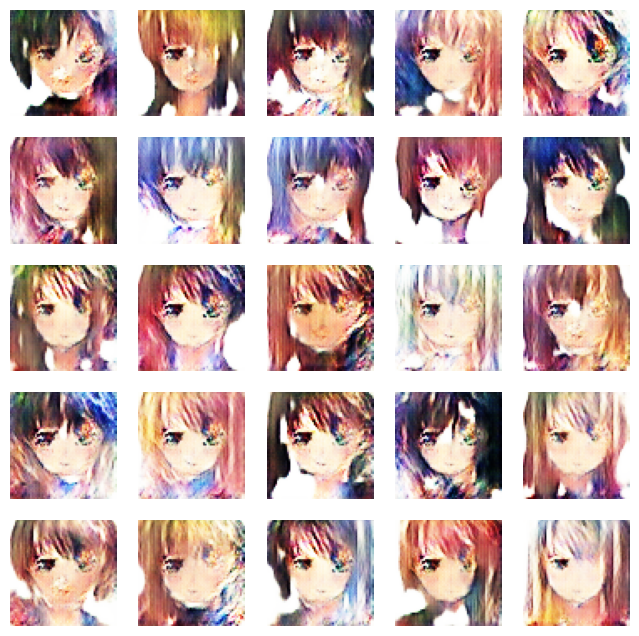

674/674 ━━━━━━━━━━━━━━━━━━━━ 81s 62ms/step - d_loss: 0.5350 - g_loss: 1.7212
Epoch 10/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5311 - g_loss: 1.7222

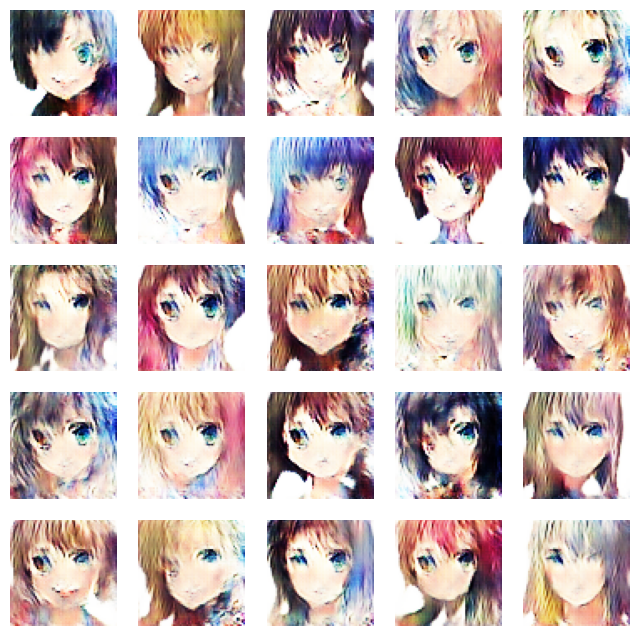

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.5311 - g_loss: 1.7220
Epoch 11/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5827 - g_loss: 1.4950

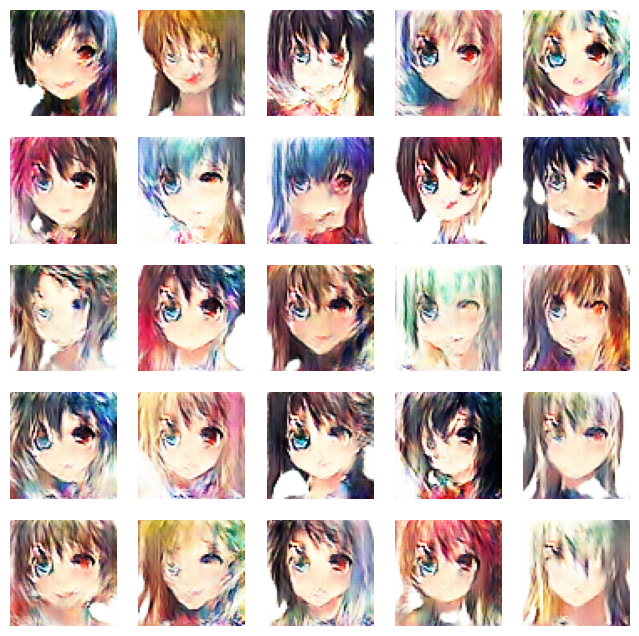

674/674 ━━━━━━━━━━━━━━━━━━━━ 81s 62ms/step - d_loss: 0.5826 - g_loss: 1.4949
Epoch 12/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.5777 - g_loss: 1.4295

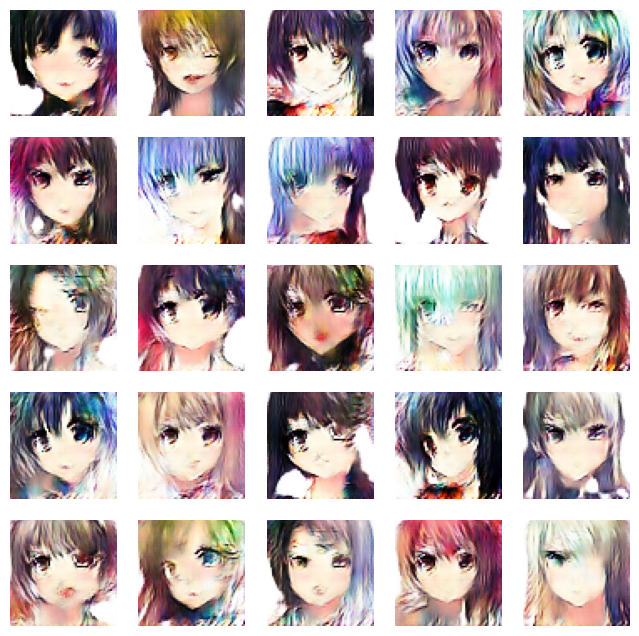

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 62ms/step - d_loss: 0.5778 - g_loss: 1.4294
Epoch 13/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6189 - g_loss: 1.2650

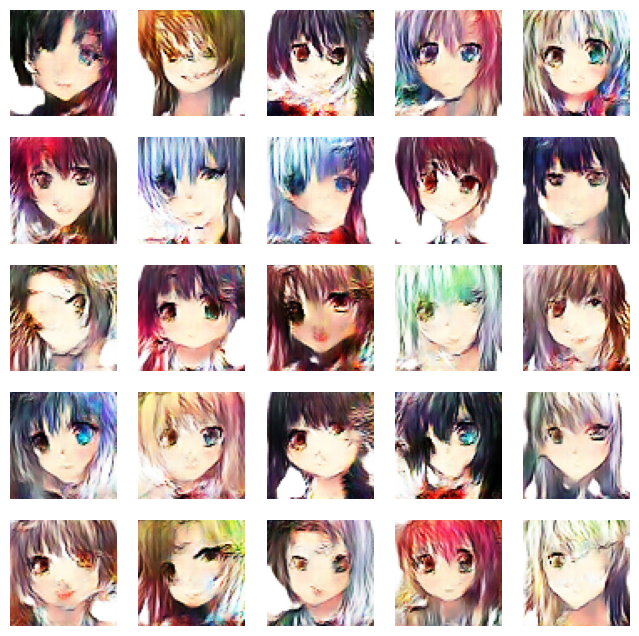

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6189 - g_loss: 1.2650
Epoch 14/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6366 - g_loss: 1.1706

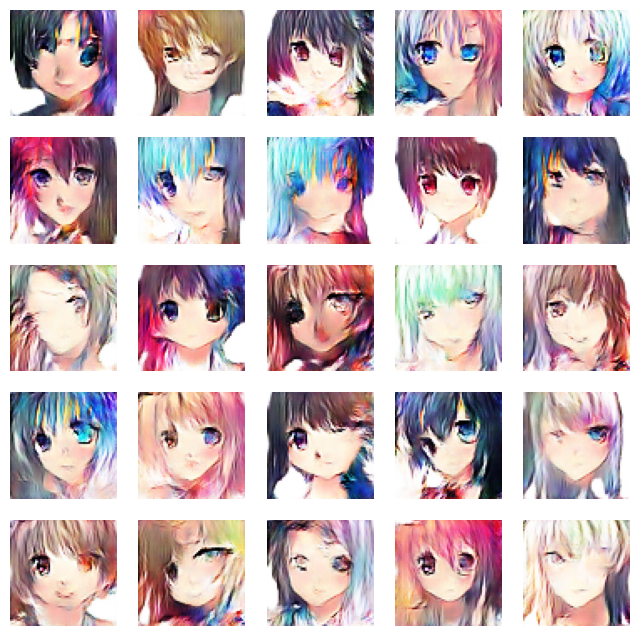

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.6366 - g_loss: 1.1705
Epoch 15/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6540 - g_loss: 1.0915

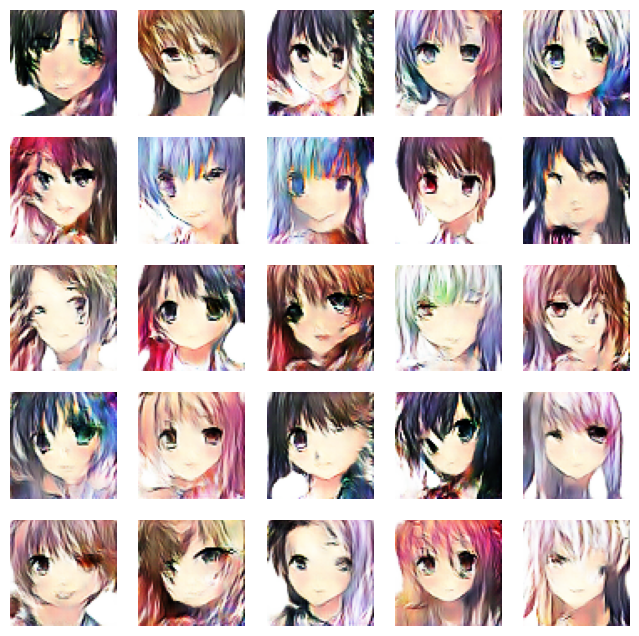

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 62ms/step - d_loss: 0.6540 - g_loss: 1.0915
Epoch 16/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6560 - g_loss: 1.0331

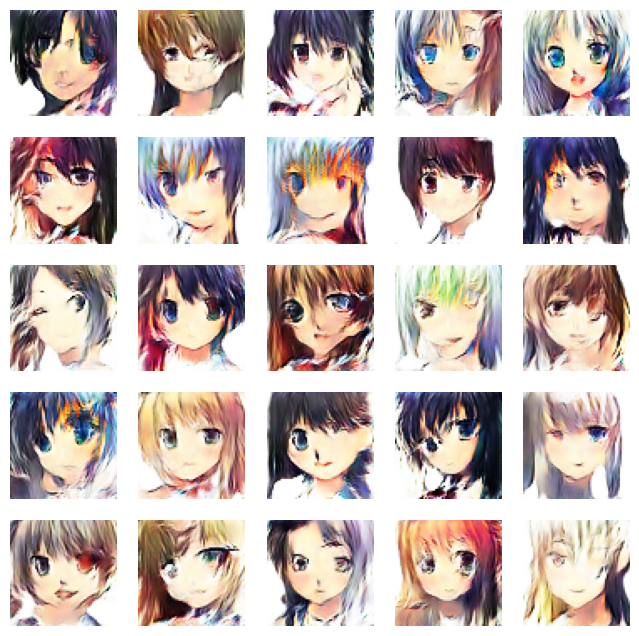

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 63ms/step - d_loss: 0.6560 - g_loss: 1.0331
Epoch 17/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6621 - g_loss: 1.0073

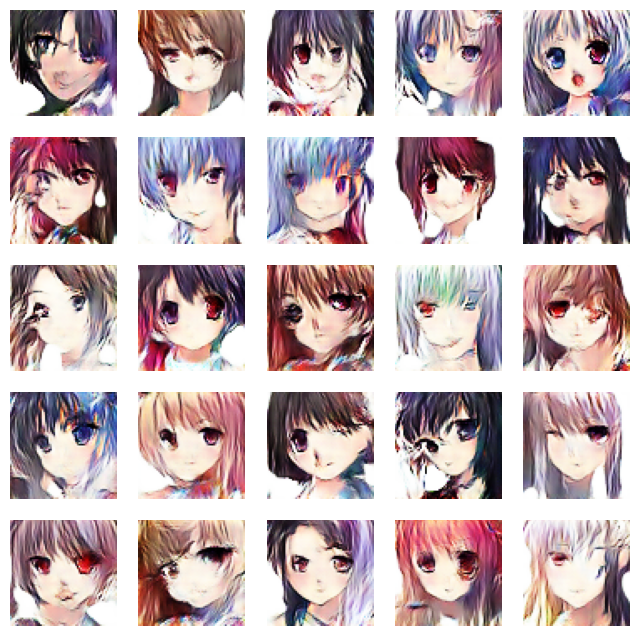

674/674 ━━━━━━━━━━━━━━━━━━━━ 41s 61ms/step - d_loss: 0.6621 - g_loss: 1.0072
Epoch 18/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6737 - g_loss: 0.9795

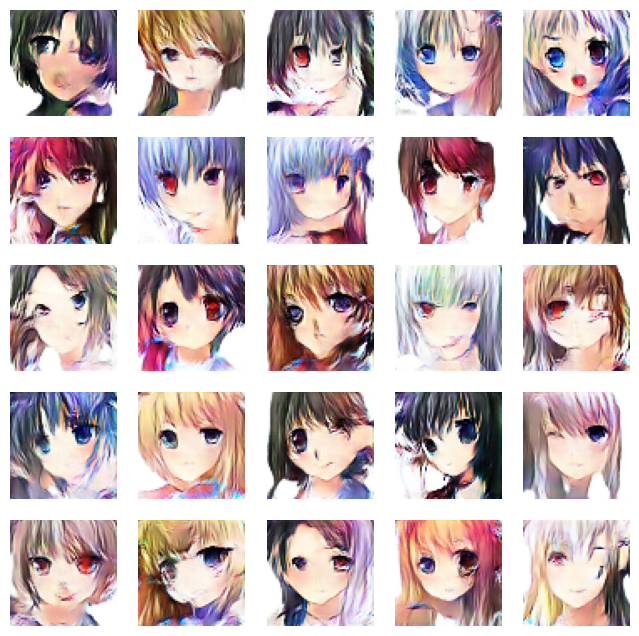

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 62ms/step - d_loss: 0.6738 - g_loss: 0.9794
Epoch 19/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6756 - g_loss: 0.9432

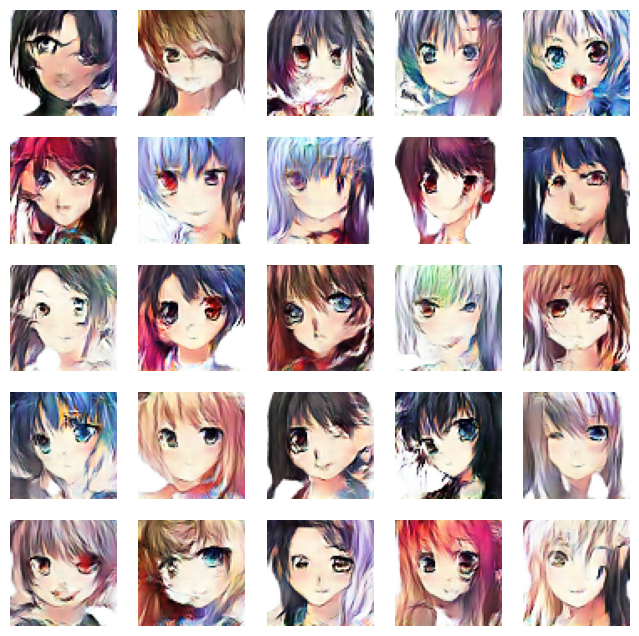

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.6756 - g_loss: 0.9432
Epoch 20/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6771 - g_loss: 0.9389

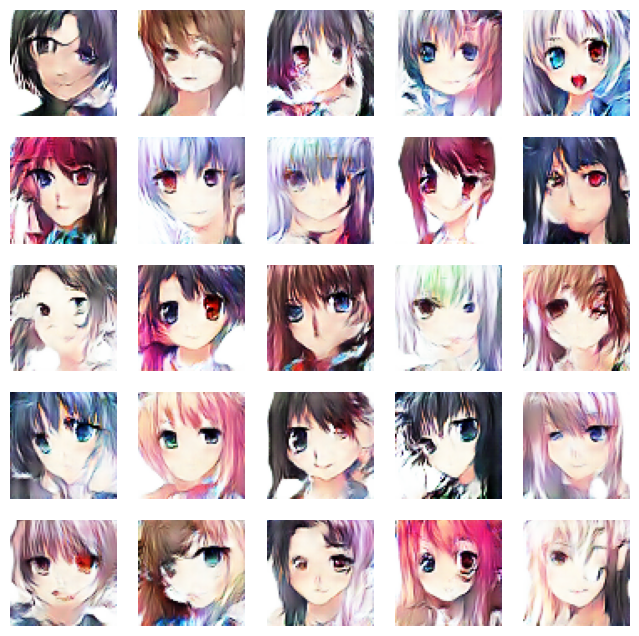

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.6771 - g_loss: 0.9388
Epoch 21/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6722 - g_loss: 0.9344

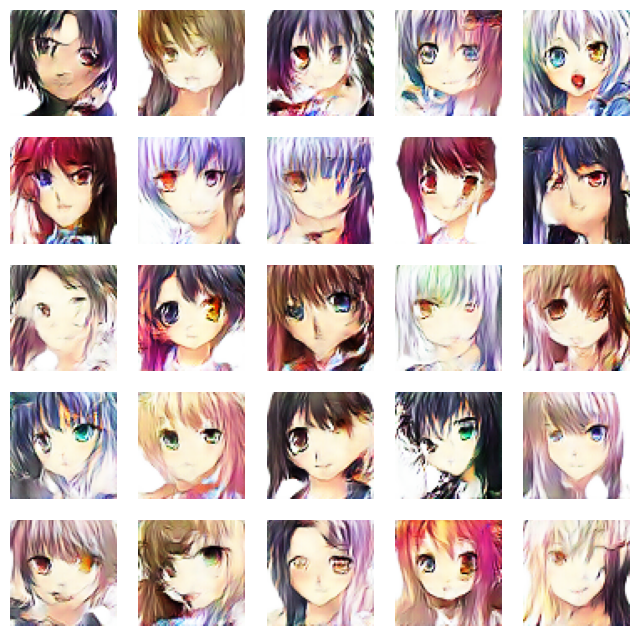

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6722 - g_loss: 0.9344
Epoch 22/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6704 - g_loss: 0.9267

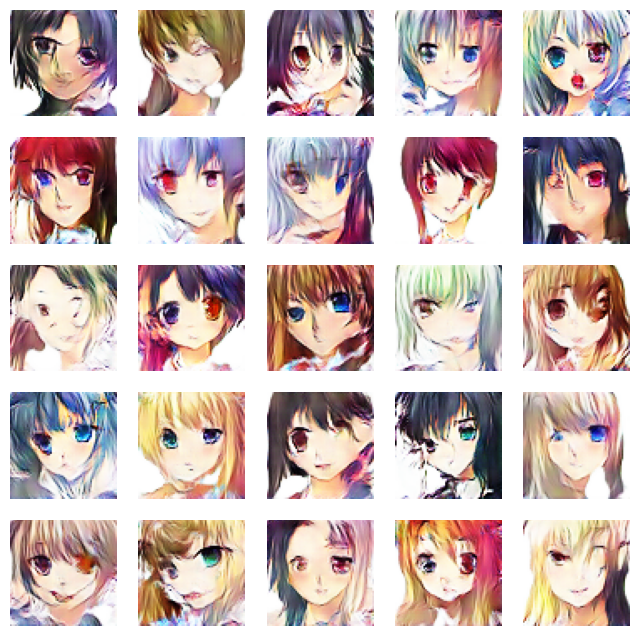

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 63ms/step - d_loss: 0.6704 - g_loss: 0.9267
Epoch 23/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6724 - g_loss: 0.9212

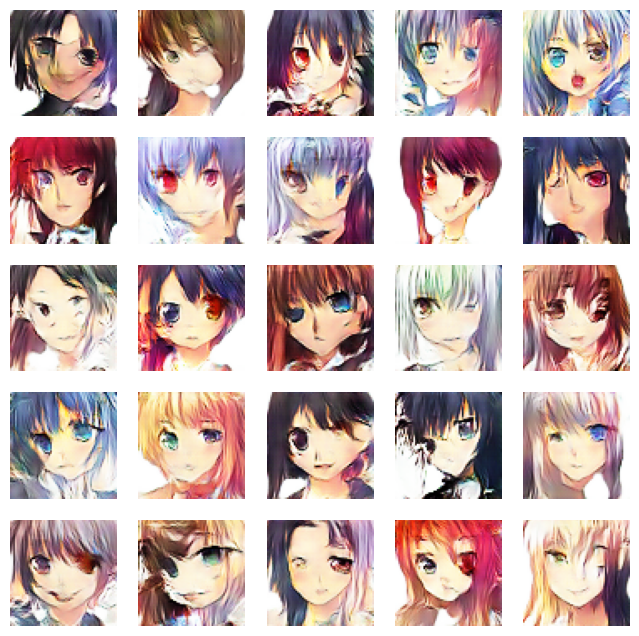

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6724 - g_loss: 0.9212
Epoch 24/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6700 - g_loss: 0.9191

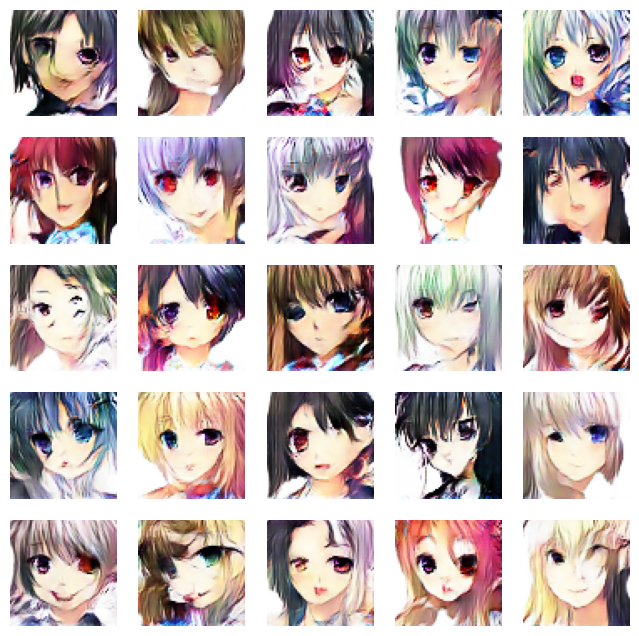

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 62ms/step - d_loss: 0.6700 - g_loss: 0.9191
Epoch 25/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6633 - g_loss: 0.9203

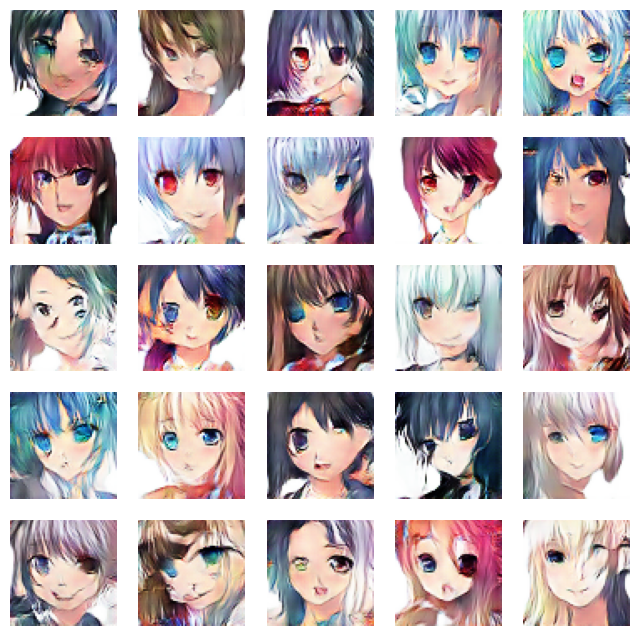

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.6633 - g_loss: 0.9203
Epoch 26/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6584 - g_loss: 0.9296

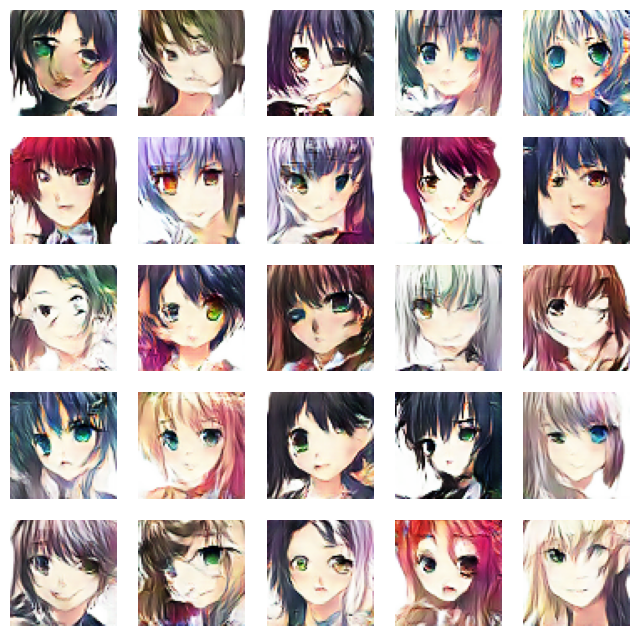

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 62ms/step - d_loss: 0.6584 - g_loss: 0.9295
Epoch 27/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6567 - g_loss: 0.9362

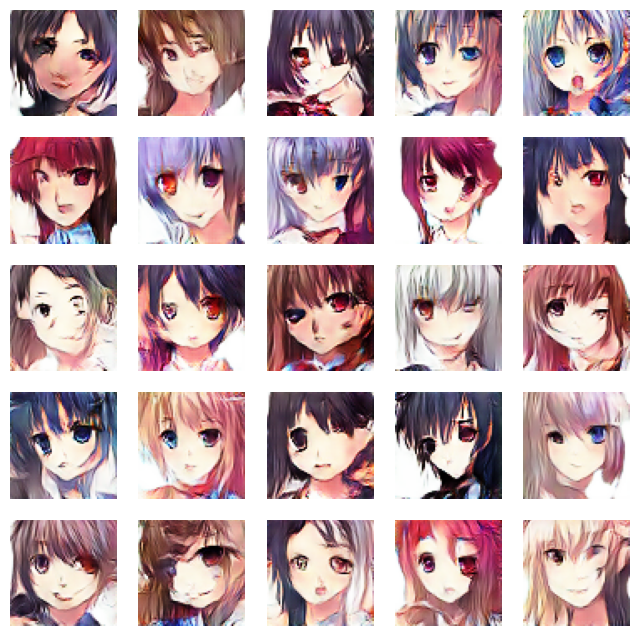

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6567 - g_loss: 0.9362
Epoch 28/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6526 - g_loss: 0.9443

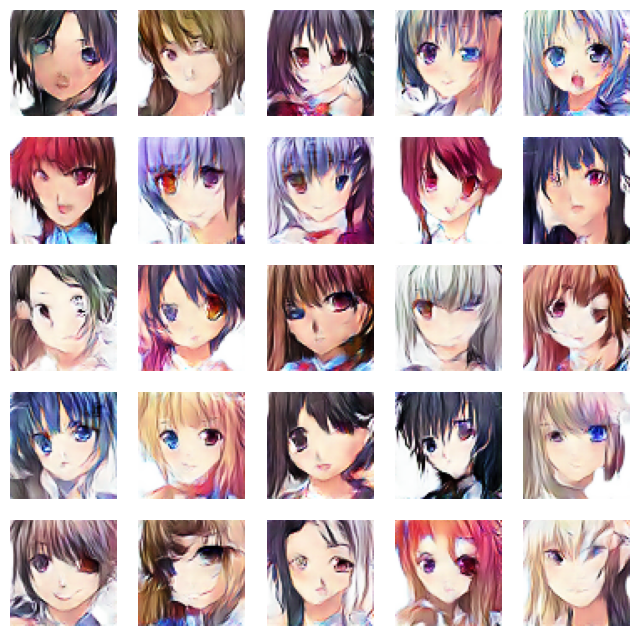

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 63ms/step - d_loss: 0.6526 - g_loss: 0.9443
Epoch 29/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6493 - g_loss: 0.9486

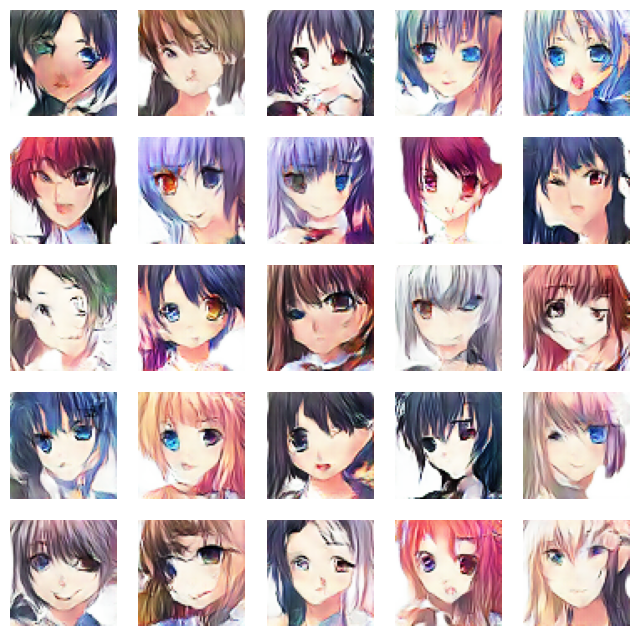

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6493 - g_loss: 0.9486
Epoch 30/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6448 - g_loss: 0.9488

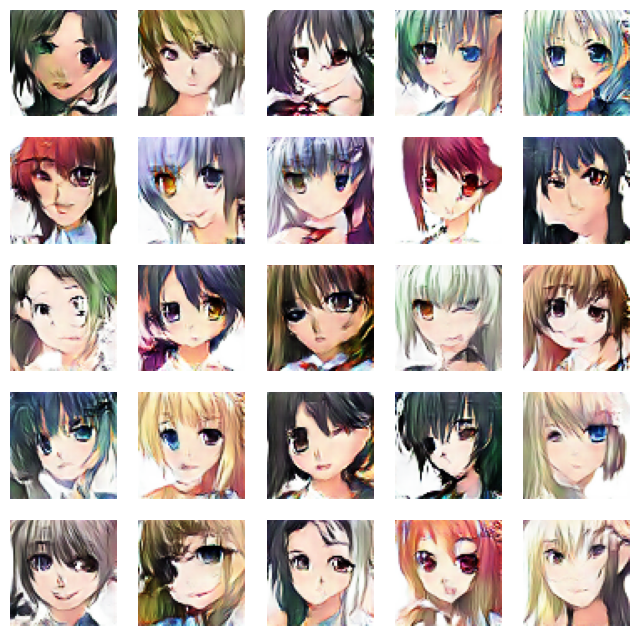

674/674 ━━━━━━━━━━━━━━━━━━━━ 84s 65ms/step - d_loss: 0.6448 - g_loss: 0.9488
Epoch 31/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6432 - g_loss: 0.9524

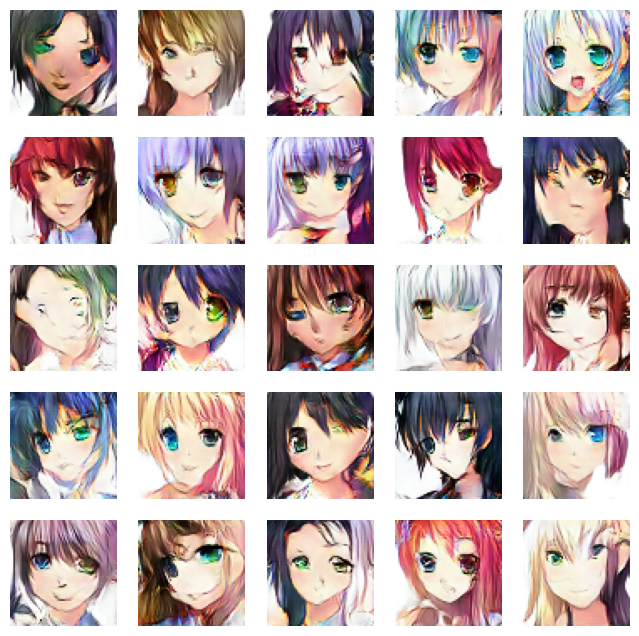

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6432 - g_loss: 0.9524
Epoch 32/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.6383 - g_loss: 0.9590

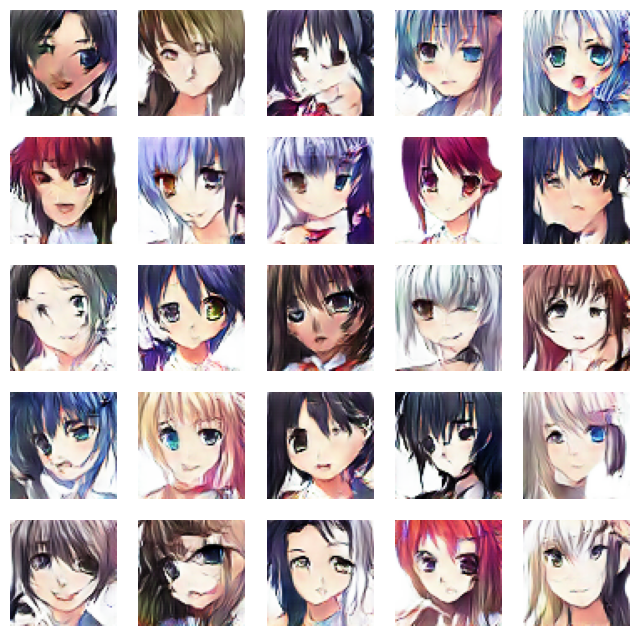

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.6383 - g_loss: 0.9590
Epoch 33/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6395 - g_loss: 0.9726

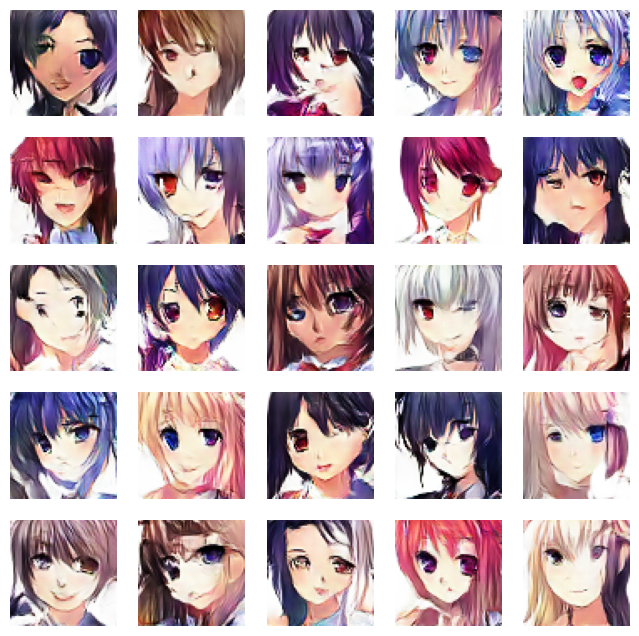

674/674 ━━━━━━━━━━━━━━━━━━━━ 81s 62ms/step - d_loss: 0.6395 - g_loss: 0.9726
Epoch 34/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6356 - g_loss: 0.9809

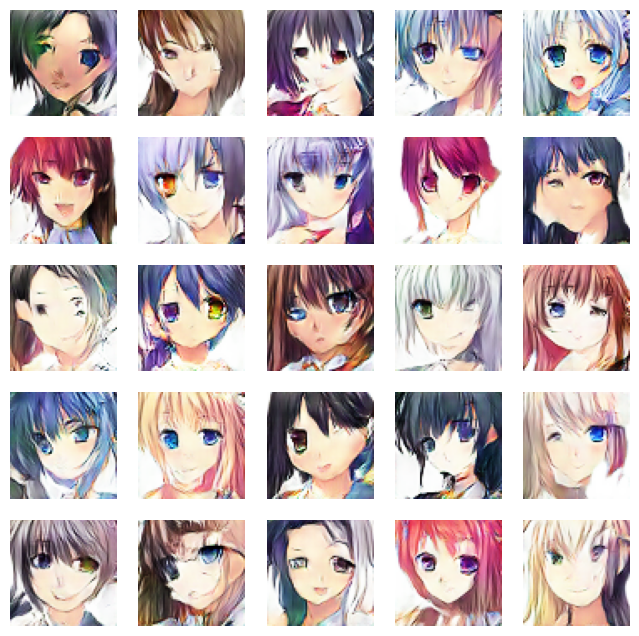

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.6356 - g_loss: 0.9809
Epoch 35/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6328 - g_loss: 0.9884

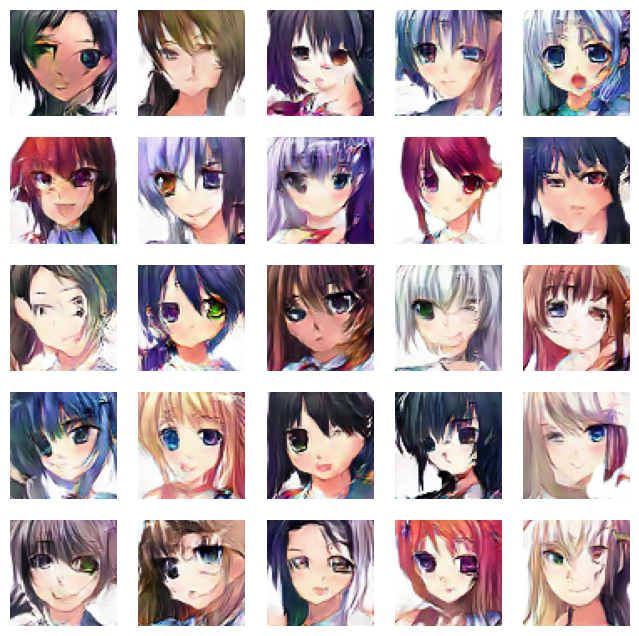

674/674 ━━━━━━━━━━━━━━━━━━━━ 41s 61ms/step - d_loss: 0.6328 - g_loss: 0.9884
Epoch 36/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6292 - g_loss: 0.9842

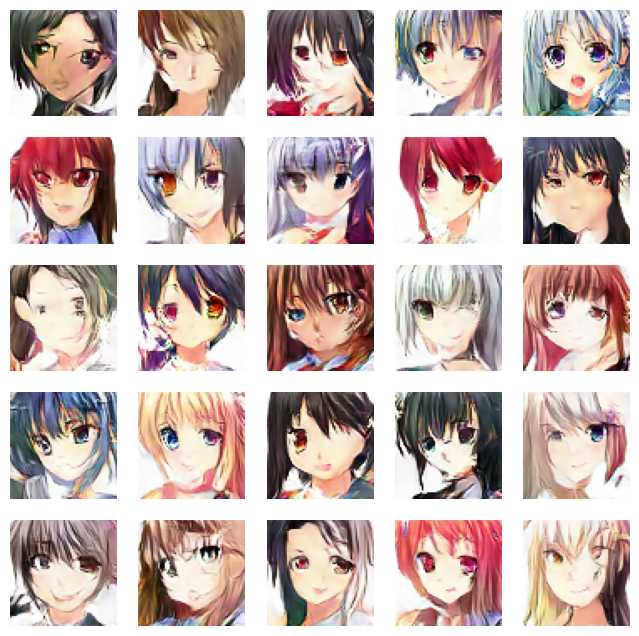

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 62ms/step - d_loss: 0.6292 - g_loss: 0.9842
Epoch 37/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6277 - g_loss: 1.0042

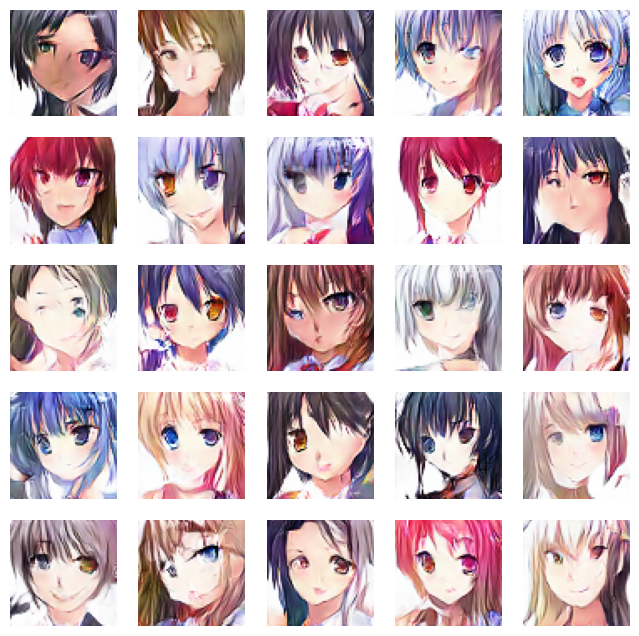

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.6277 - g_loss: 1.0042
Epoch 38/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6199 - g_loss: 1.0150

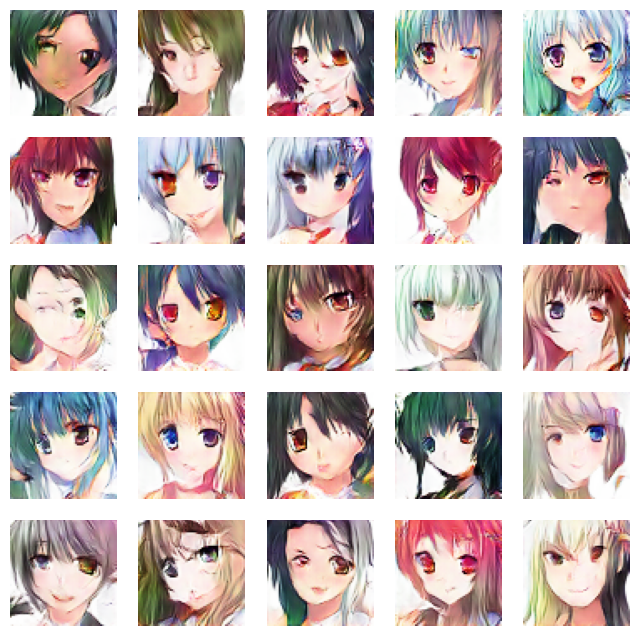

674/674 ━━━━━━━━━━━━━━━━━━━━ 81s 62ms/step - d_loss: 0.6200 - g_loss: 1.0150
Epoch 39/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6183 - g_loss: 1.0144

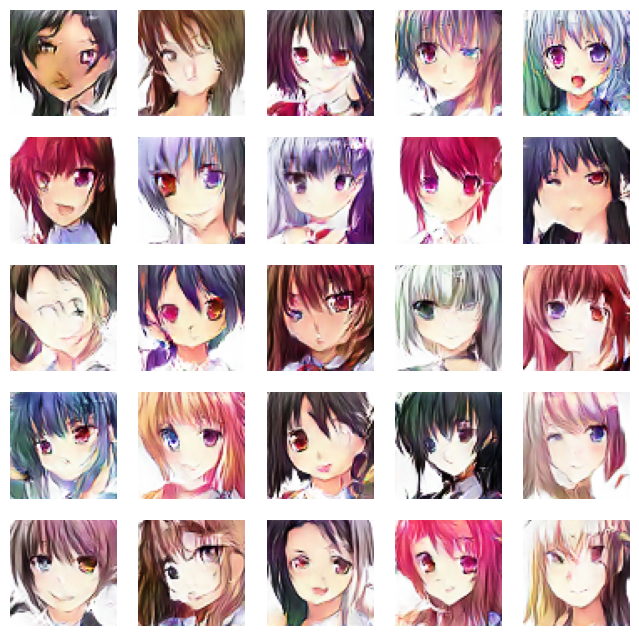

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 63ms/step - d_loss: 0.6183 - g_loss: 1.0144
Epoch 40/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6140 - g_loss: 1.0384

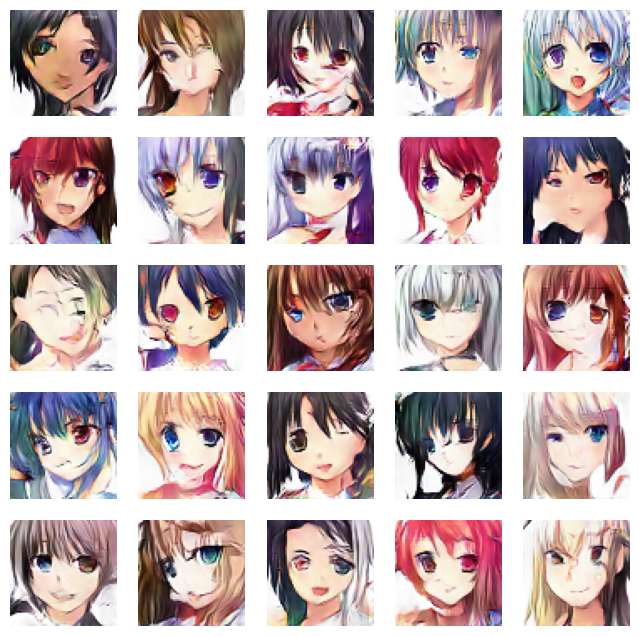

674/674 ━━━━━━━━━━━━━━━━━━━━ 81s 62ms/step - d_loss: 0.6140 - g_loss: 1.0383
Epoch 41/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6164 - g_loss: 1.0474

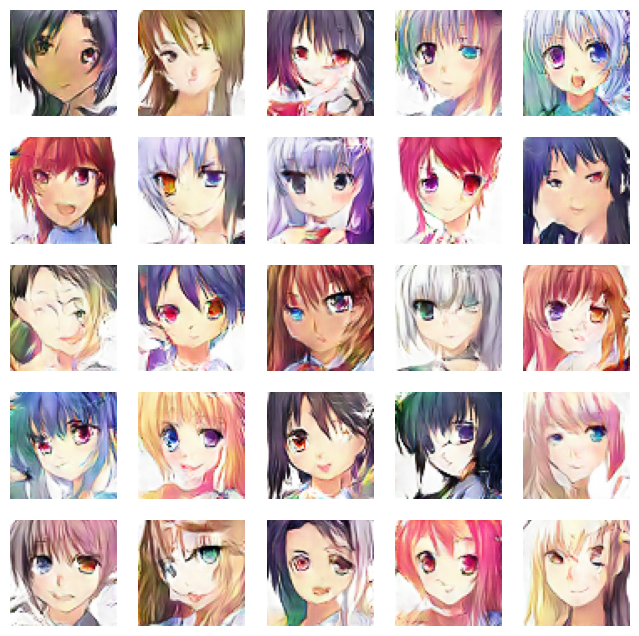

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 62ms/step - d_loss: 0.6164 - g_loss: 1.0474
Epoch 42/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6059 - g_loss: 1.0493

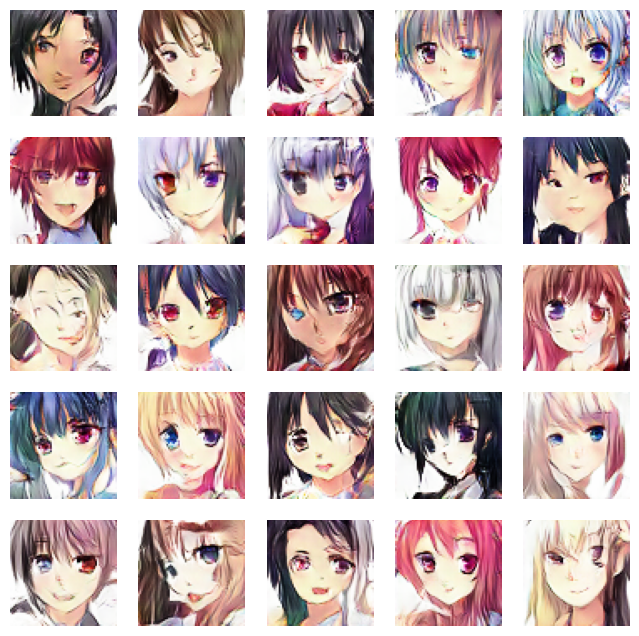

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.6059 - g_loss: 1.0493
Epoch 43/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6063 - g_loss: 1.0693

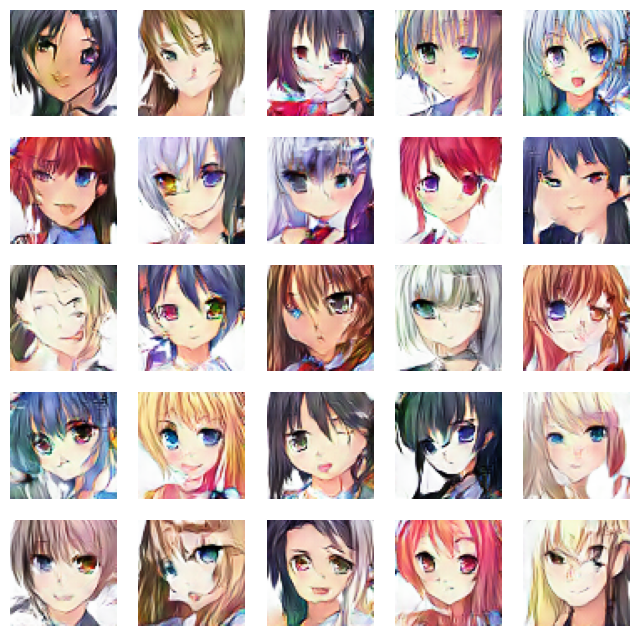

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 62ms/step - d_loss: 0.6063 - g_loss: 1.0693
Epoch 44/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.5970 - g_loss: 1.0794

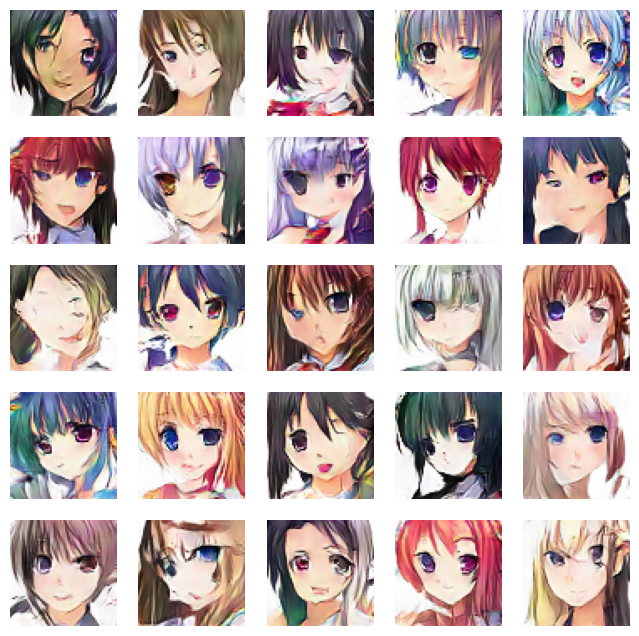

674/674 ━━━━━━━━━━━━━━━━━━━━ 41s 61ms/step - d_loss: 0.5970 - g_loss: 1.0794
Epoch 45/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.5951 - g_loss: 1.1023

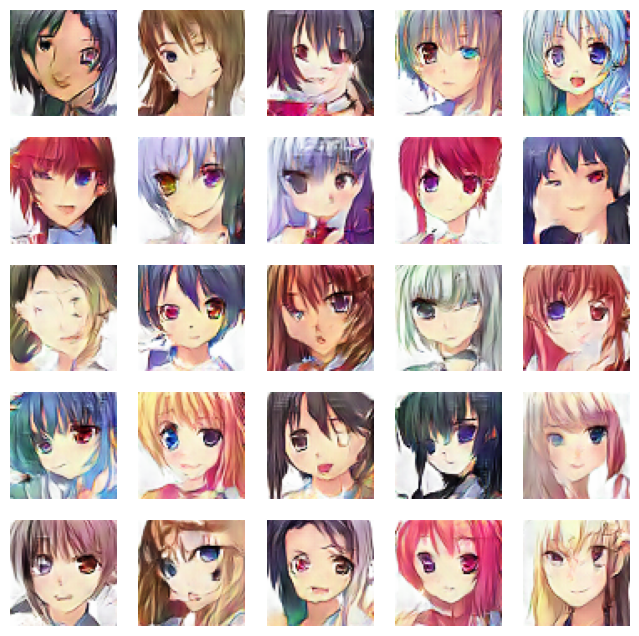

674/674 ━━━━━━━━━━━━━━━━━━━━ 42s 62ms/step - d_loss: 0.5951 - g_loss: 1.1023
Epoch 46/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5889 - g_loss: 1.1174

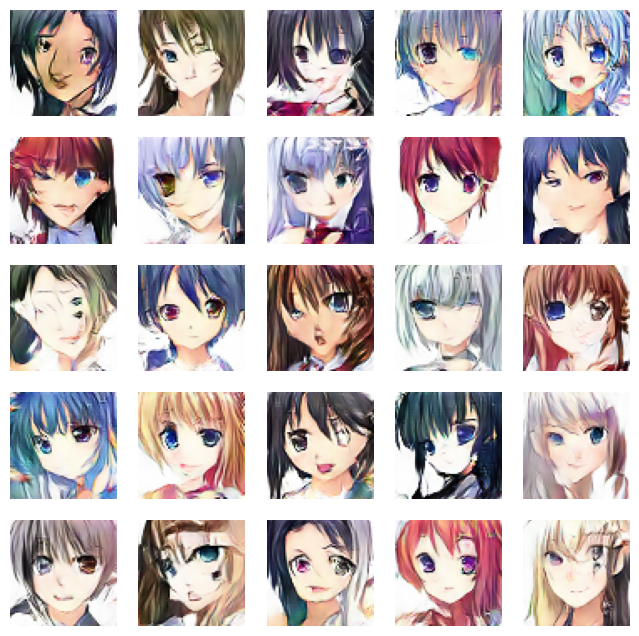

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 61ms/step - d_loss: 0.5890 - g_loss: 1.1174
Epoch 47/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5828 - g_loss: 1.1335

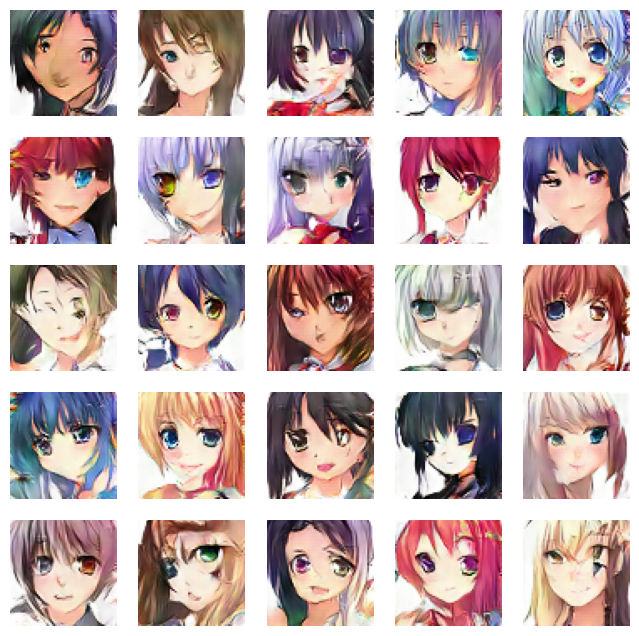

674/674 ━━━━━━━━━━━━━━━━━━━━ 41s 62ms/step - d_loss: 0.5828 - g_loss: 1.1335
Epoch 48/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5831 - g_loss: 1.1547

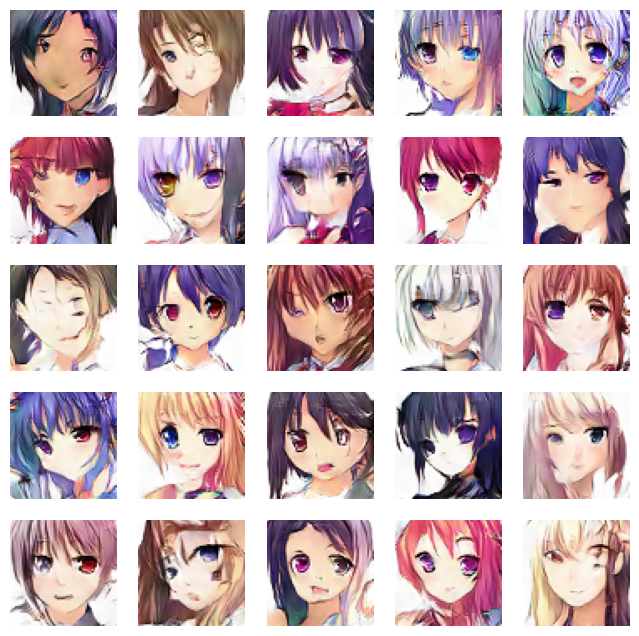

674/674 ━━━━━━━━━━━━━━━━━━━━ 83s 63ms/step - d_loss: 0.5831 - g_loss: 1.1547
Epoch 49/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5733 - g_loss: 1.1678

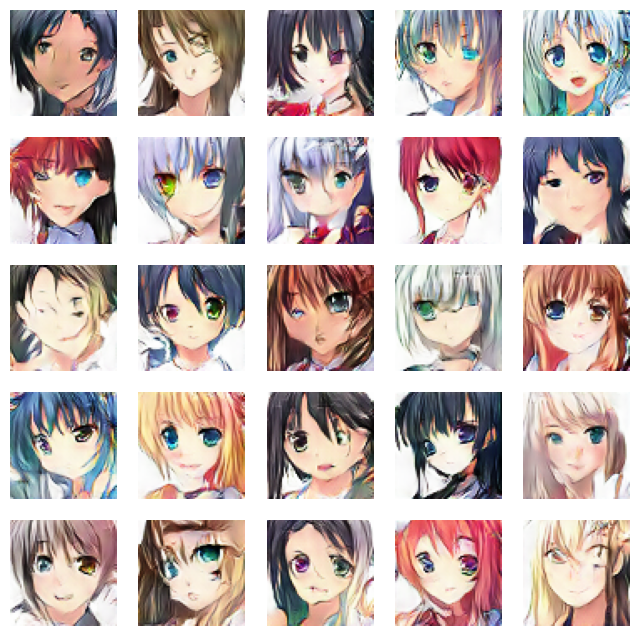

674/674 ━━━━━━━━━━━━━━━━━━━━ 81s 62ms/step - d_loss: 0.5733 - g_loss: 1.1678
Epoch 50/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5694 - g_loss: 1.1794

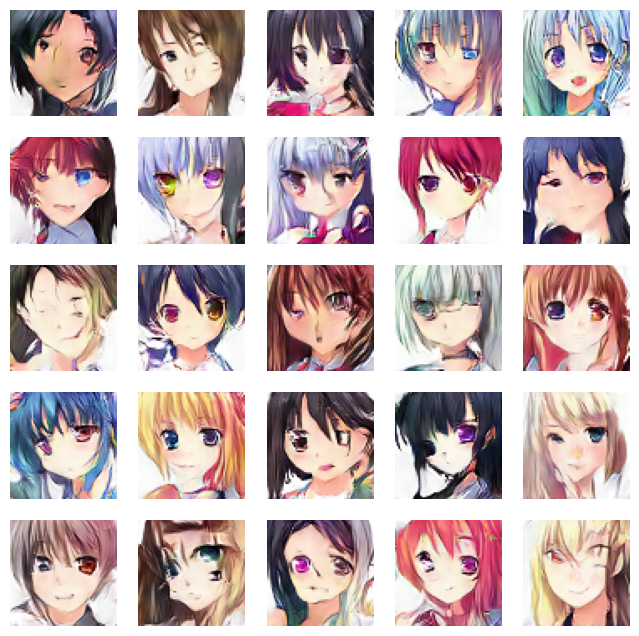

674/674 ━━━━━━━━━━━━━━━━━━━━ 82s 62ms/step - d_loss: 0.5694 - g_loss: 1.1794


In [28]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])


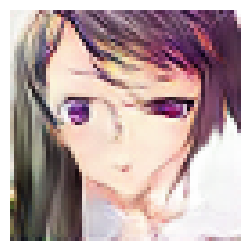

In [29]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
g_img = dcgan.generator(noise)
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()